# Analysis of aircraft Dopplers seen on reflections of a 2.3GHz beacon

In this notebook we analyse a recording of aircrafts reflections of a 2.3GHz beacon. The waterfall of the recording is matched with ADS-B data to see the trajectories and locations where the reflections are produced.

In [1]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import matplotlib.dates as mdates

import datetime
import time

from matplotlib.collections import LineCollection
from matplotlib.colors import ListedColormap

from matplotlib.dates import DayLocator, HourLocator, MinuteLocator, DateFormatter

import pathlib

import json
import pickle

import pymap3d

import cartopy.crs as ccrs
from cartopy.io.img_tiles import OSM

c = 299792458 # speed of light (m/s)

Functions to compute various geometric transformations of aircraft positions and Doppler.

In [2]:
def ac_geodetic(ac):
    return (ac['Lat'], ac['Long'], ac['GAlt'] * 0.3048)

def ac_ecef(ac):
    return np.array(pymap3d.geodetic2ecef(*ac_geodetic(ac)))

def ac_vel(ac):
    angle = ac['Trak'] * np.pi / 180
    spd = ac['Spd'] * 0.514444
    try:
        vspd = ac['Vsi'] * 0.00508 # vertical speed
    except KeyError:
        vspd = 0
    return np.array(pymap3d.ned2ecef(spd * np.cos(angle), spd * np.sin(angle), -vspd, ac['Lat'], ac['Long'], ac['GAlt'] * 0.3048)) - ac_ecef(ac)

def one_way_doppler(ac, obs, freq):
    v = ac_vel(ac)
    x = ac_ecef(ac) - obs
    return - np.sum(v * x)/np.sqrt(np.sum(x**2)) * freq / c

def two_way_doppler(ac, obs1, obs2, freq):
    return one_way_doppler(ac, obs1, freq) + one_way_doppler(ac, obs2, freq)

def ac_aer(ac, obs_g):
    return pymap3d.geodetic2aer(*(ac_geodetic(ac) + obs_g))

Bounding box to filter aircraft positions.

In [3]:
lat_start = 40.5
long_start = -3.85
lat_end = 40.8
long_end = -3.45

def filter_ac(ac):
    needed_keys = ['GAlt', 'Trak', 'Spd', 'PosTime']
    try:
        [ac[k] for k in needed_keys]
        return (ac['Lat'] >= lat_start) and (ac['Lat'] <= lat_end) and (ac['Long'] >= long_start) and (ac['Long'] <= long_end)
    except KeyError:
        return False

Uncomment the cell below to read aircraft ADS-B data from JSON files from [adsbexchange.com](https://www.adsbexchange.com/data/). This is not needed for normal operation, since the filtered data is provided as a pickled file, to be loaded below.

In [4]:
#aircrafts = list()
#for p in ['/home/daniel/t/mnt/common/no-backup/ac/2018-07-08-{:02d}{:02d}Z.json'.format(hour, minute) for hour in range(10,12) for minute in range(60)]:
#    with open(str(p)) as f:
#        data = f.read()
#        data = data.replace(',,',',').replace('[\n,','[\n').replace(',]', ']') # fix invalid JSON files
#        try:
#            aircrafts.extend(filter(filter_ac, json.loads(data)['acList']))
#        except json.JSONDecodeError as e:
#            print(str(p))
#            raise(e)

Uncomment the cell below to save the aircraft ADS-B data in a pickled file, for later use.

In [5]:
#with open('aircrafts_20180708.pickle', 'wb') as f:
#    pickle.dump(aircrafts, f)

Load the aircraft ADS-B data from the pickled file.

In [6]:
with open('aircrafts_20180708.pickle', 'rb') as f:
    aircrafts = list(filter(filter_ac, pickle.load(f)))

Build set with ICAO hex ids of all aircrafts. This is used below to iterate for each aircraft.

In [7]:
icaos = {ac['Icao'] for ac in aircrafts}

Locations of the recording station (EA4GPZ) and the beacon.

In [8]:
ea4gpz_coords = (40.62045, -3.694666, 700)
beacon_coords = (40.660600, -3.769186, 800) # location approximate
freq = 2320865e3

obs1 = pymap3d.geodetic2ecef(*ea4gpz_coords)
obs2 = pymap3d.geodetic2ecef(*beacon_coords)

Function to plot a map using openstreetmaps. The recording station (EA4GPZ) is marked as a red circle and the beacon is marked as an orange circle.

In [9]:
imagery = OSM()
def plot_map(imagery_size = 12):
    plt.figure(figsize=[20,20])
    ax = plt.axes(projection=imagery.crs)
    ax.set_extent((long_start, long_end, lat_start, lat_end))
    ax.add_image(imagery, imagery_size)
    plt.plot(ea4gpz_coords[1], ea4gpz_coords[0], 'o', markersize=10, color='red', transform=ccrs.Geodetic())
    plt.plot(beacon_coords[1], beacon_coords[0], 'o', markersize=10, color='orange', transform=ccrs.Geodetic())
    return ax

Plot aircraft trajectories coloured by Doppler. Red is positive Doppler, blue is negative Doppler.

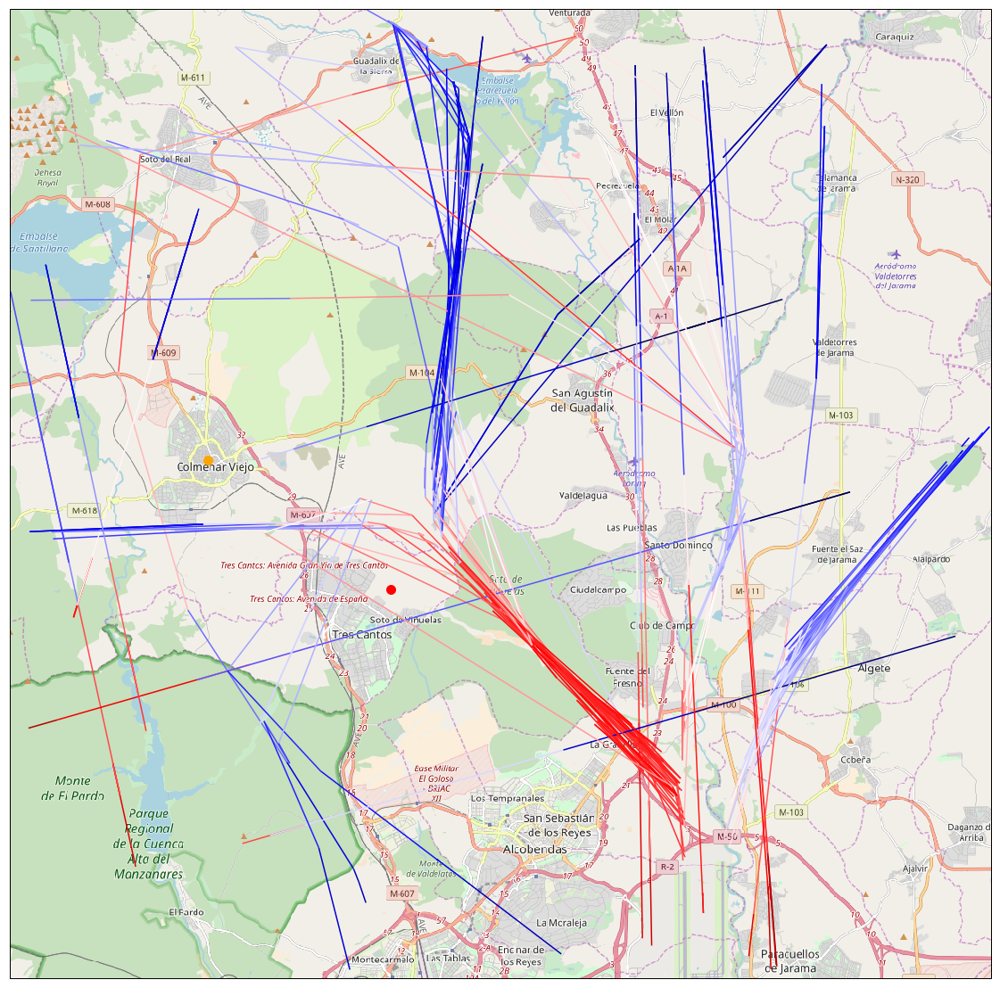

In [10]:
ax = plot_map()
norm = plt.Normalize(-3000, 3000)
for icao in icaos:
    x = np.array([ac['Long'] for ac in aircrafts if ac['Icao'] == icao])
    y = np.array([ac['Lat'] for ac in aircrafts if ac['Icao'] == icao])
    dopplers = np.array([two_way_doppler(ac, obs1, obs2, freq) for ac in aircrafts if ac['Icao'] == icao])
    points = np.array([x, y]).T.reshape(-1, 1, 2)
    segments = np.concatenate([points[:-1], points[1:]], axis=1)
    lc = LineCollection(segments, cmap='seismic', norm=norm, transform=ccrs.Geodetic())
    lc.set_array(0.5*(dopplers[:-1] + dopplers[1:]))
    line = ax.add_collection(lc)

Load waterfall data from .npz file. This has been obtained from the wav recording by the script waterfall_13cm.py. Also set some auxiliary variables related to the recording.

In [11]:
waterfall = np.load('data_13cm.npz')['waterfall'][:,::-1].T
image_start =  datetime.datetime(2018, 7, 8, 10, 3, 11, tzinfo = datetime.timezone.utc)
secs_per_l = 2**11*10/48000
seconds_per_line = datetime.timedelta(seconds = secs_per_l)
hz_per_bin = 48000/2**12
chunk = int(10*60/secs_per_l)
freq_offset = 400
freq_limits = (-3000 + freq_offset, 3000 + freq_offset)

Function to plot the waterfall in chunks and overlay aircraft Doppler traces. A selection of these traces can be marked in orange (to show aircrafts that produce reflections, for instance). The traces are annotated with the aircraft's callsign and ICAO hex id. The function returns a list of the ICAO id's that have been shown in the plot (those corresponding to the waterfall timespan).

In [12]:
def plot_doppler(icaos = set(), selection = set()):
    icaos_shown = set()
    for j in range(0, waterfall.shape[1], chunk):
        k = j + chunk
        time_limits = (image_start + j*seconds_per_line, image_start + k*seconds_per_line)
        time_limits_imshow = mdates.date2num(time_limits)
        fig, ax = plt.subplots(figsize=[20,20], facecolor='w')
        
        for icao in icaos:
            acs = [ac for ac in aircrafts if ac['Icao'] == icao]
            acs.sort(key=lambda x: x['PosTime'])
            acs = np.array(acs)
            dopplers = np.array([two_way_doppler(ac, obs1, obs2, freq) for ac in acs])
            times = np.array([datetime.datetime.fromtimestamp(ac['PosTime'] * 1e-3 , tz = datetime.timezone.utc) for ac in acs])
            times_valid = (times > time_limits[0]) & (times < time_limits[1])
            acs_visible = acs[times_valid]
            dopplers_visible = dopplers[times_valid]
            times_visible = times[times_valid]
            if acs.size < 2 or acs_visible.size < 1:
                continue
            icaos_shown.add(icao)
            tracecolor = 'orange' if icao in selection else 'white'
            ax.plot(times, dopplers, '.:', color = tracecolor, alpha = 1)
            try:
                text = f"{acs_visible[0]['Call']}\n{acs_visible[0]['Icao']}"
            except KeyError:
                text = f"{acs_visible[0]['Icao']}",
            ax.text(times_visible[0], dopplers_visible[0], text, color=tracecolor, size=12)
        ax.set_xlim(time_limits)
        ax.imshow(waterfall[:,j:k],\
                  extent = (time_limits_imshow[0], time_limits_imshow[1], freq_limits[0], freq_limits[1]),\
                  aspect = 0.5e-6, vmin = -120, vmax = -105)
        ax.set_ylim(freq_limits)
        ax.xaxis.set_major_locator(MinuteLocator())
        ax.xaxis.set_major_formatter(DateFormatter('%H:%M'))
        ax.set_xlabel('UTC time')
        ax.set_ylabel('Doppler (Hz)')
    return icaos_shown

First we plot the waterfall without Doppler traces.

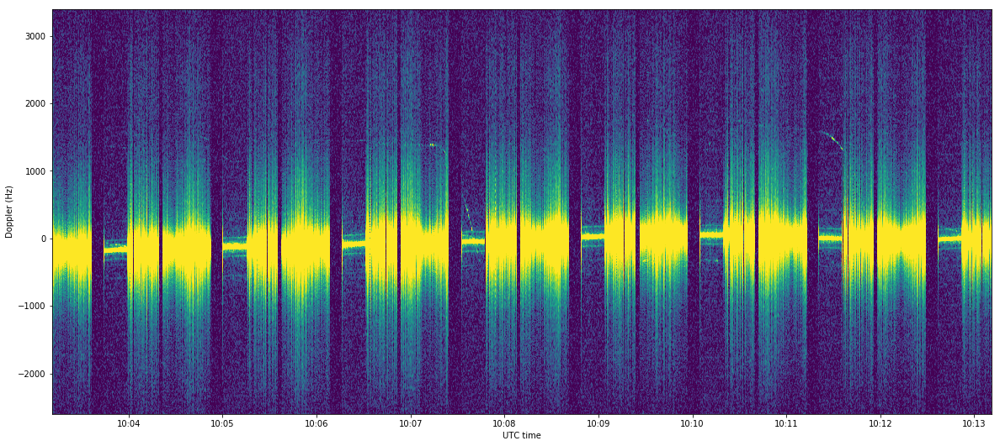

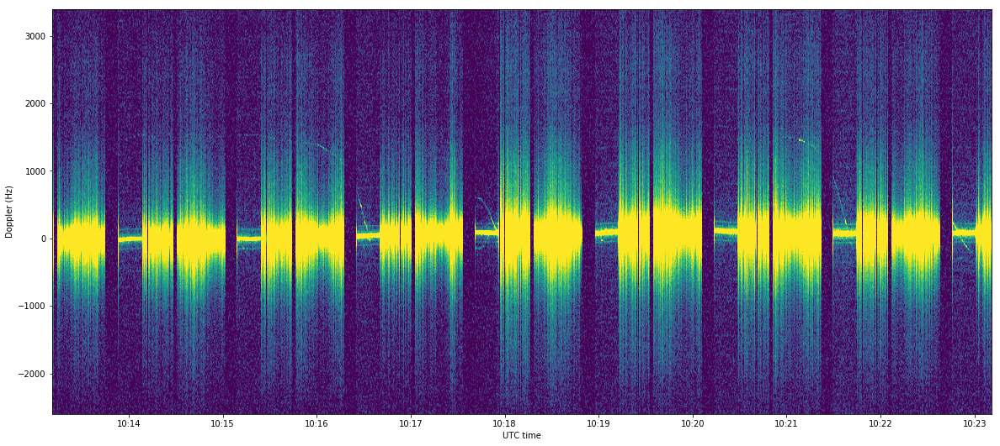

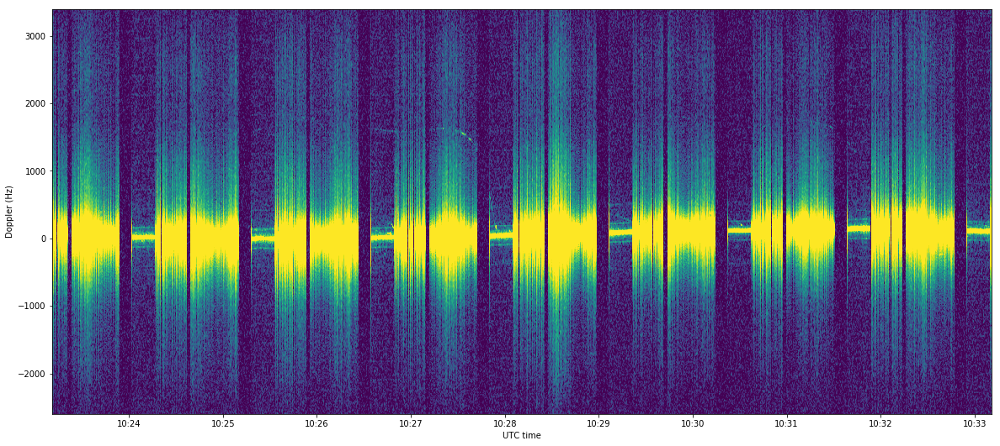

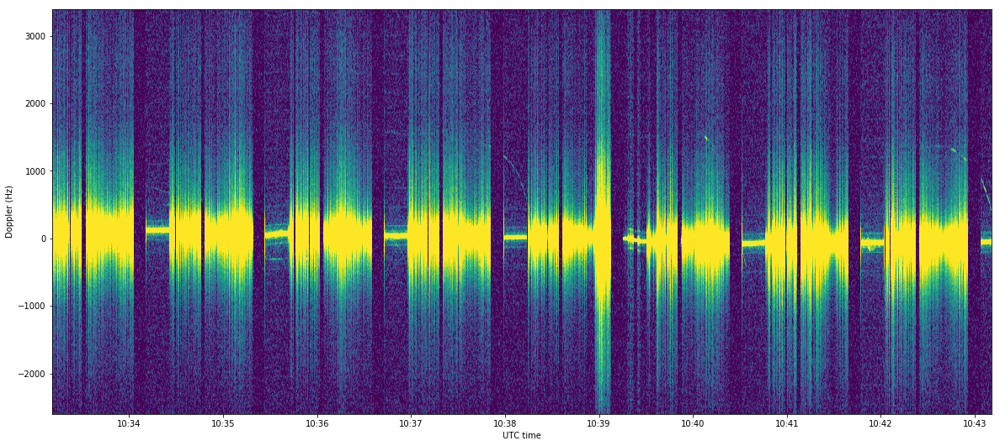

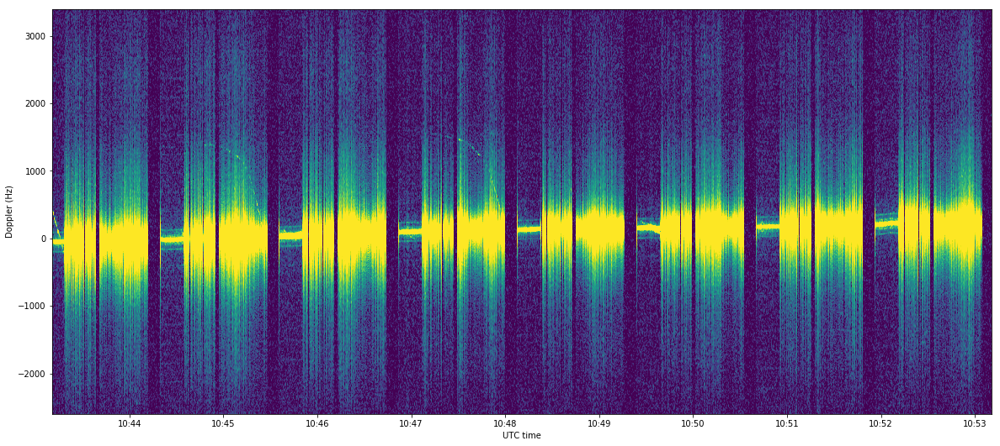

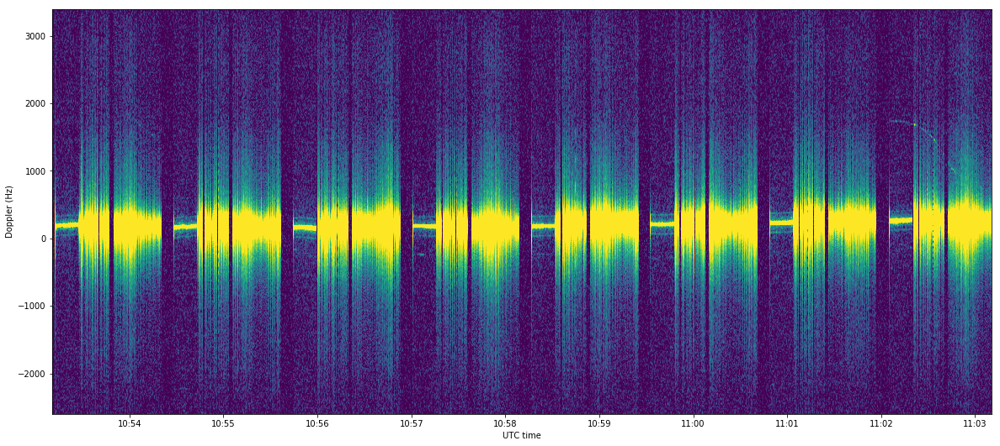

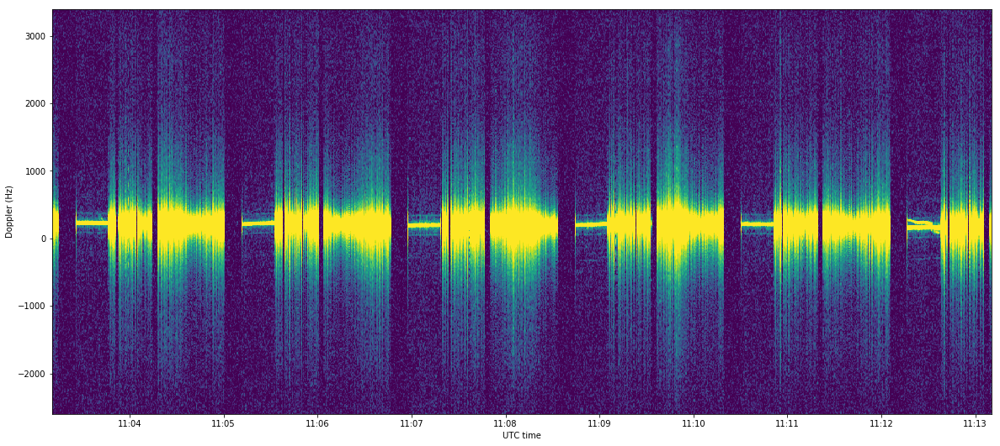

In [13]:
plot_doppler();

The following list of aircrafts that produce a reflection has been obtained by hand.

Plot all the aircraft traces, marking those that produce a reflection with an orange trace.

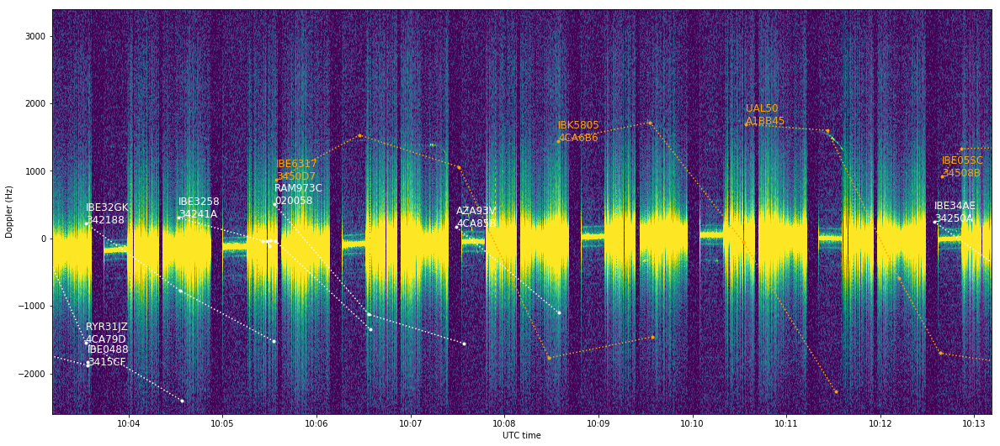

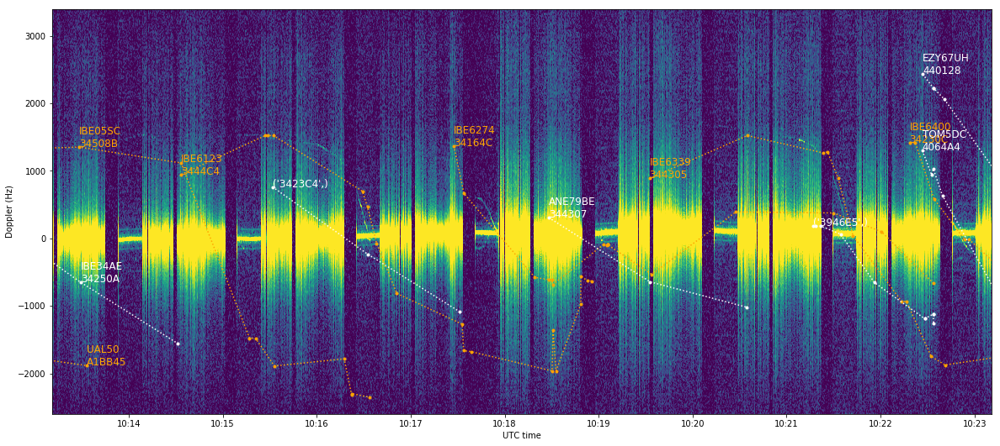

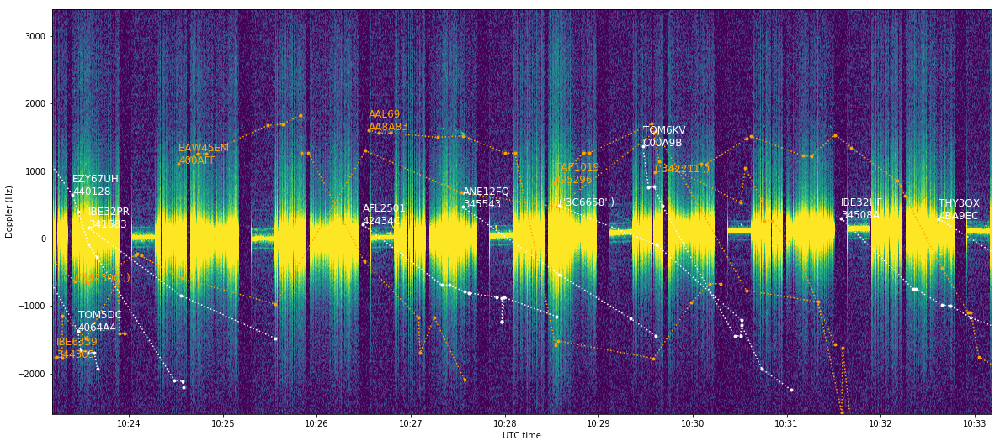

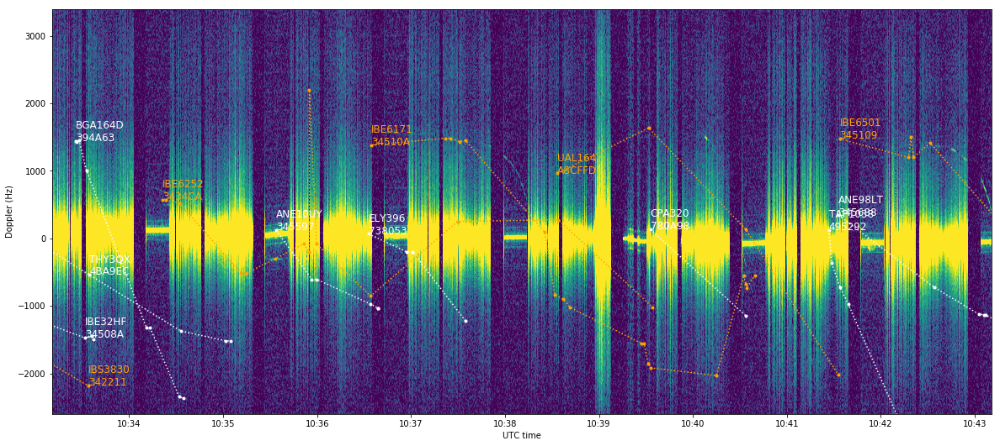

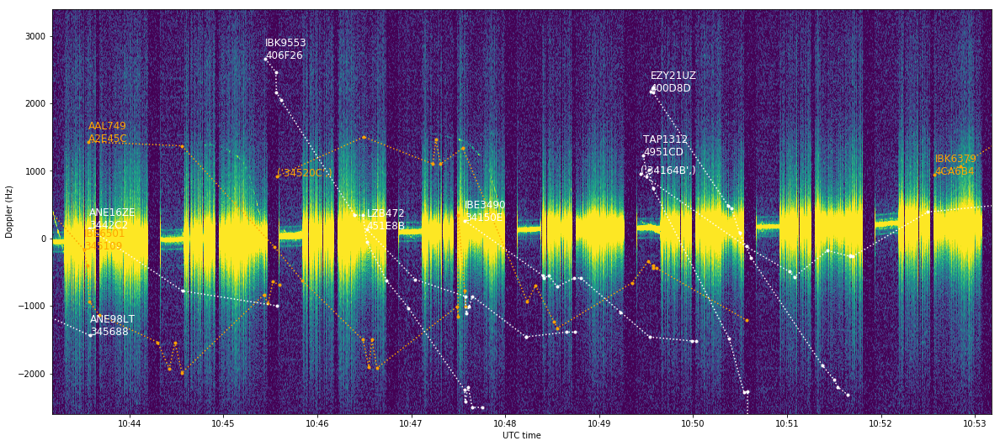

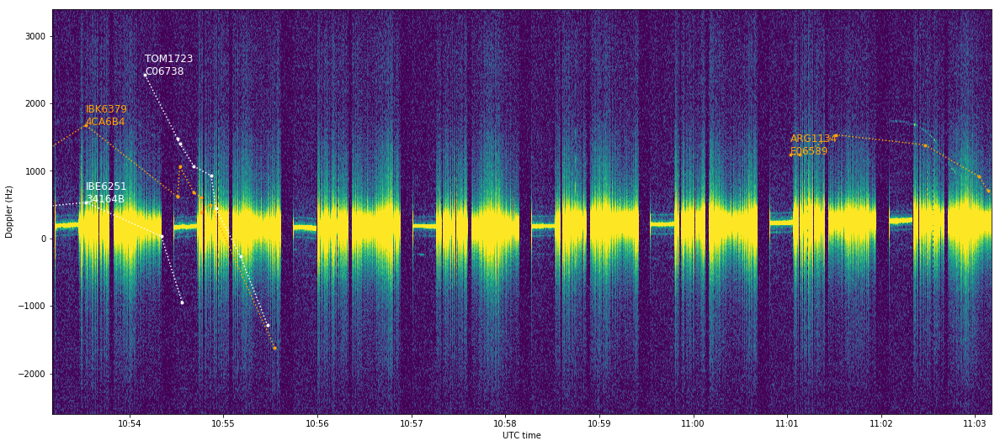

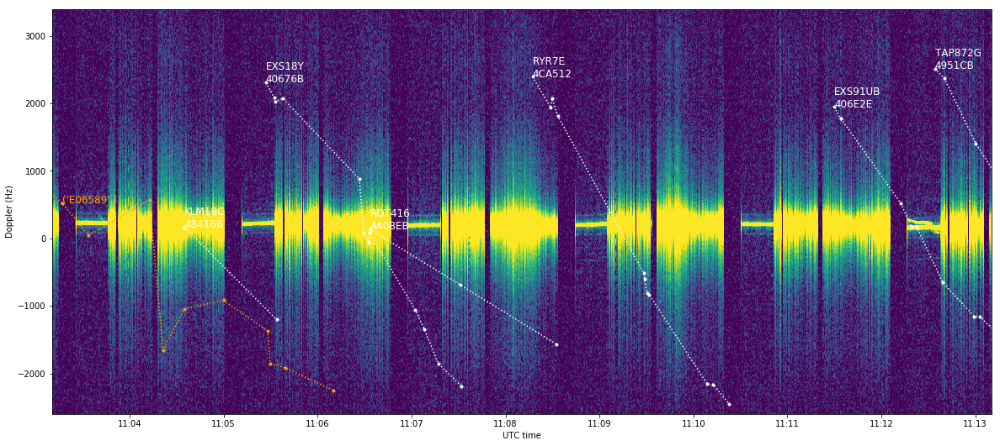

In [14]:
reflections = {'3450D7', '4CA6B6', 'A1BB45', '34508B', '3444C4', '34164C', '344305', '34230C', '400AFF', 'AA8A83',\
               '342211', '3434CA', '34510A', 'A8CFFD', '345109', 'A2E45C', '34520C', '4CA6B4', 'E06589', '495296',\
               '400AFF'}

icaos_shown = plot_doppler(icaos, reflections)

Show a map of aircraft paths which produce a reflection (in red) and those that don't (in blue).

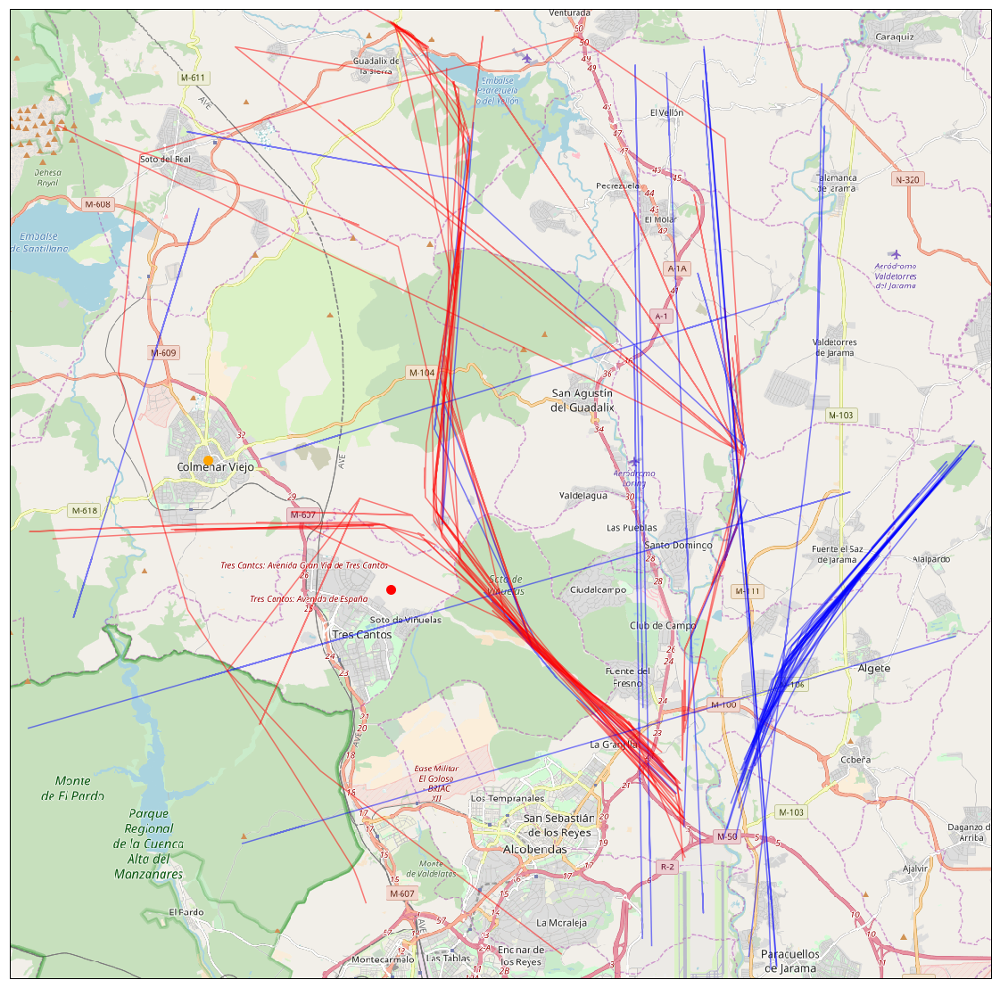

In [15]:
ax = plot_map()
for icao in icaos_shown:
    color = 'red' if icao in reflections else 'blue'
    acs = [ac for ac in aircrafts if ac['Icao'] == icao]
    ax.plot([ac['Long'] for ac in acs], [ac['Lat'] for ac in acs], '-', color = color, alpha = 0.5,\
            transform=ccrs.Geodetic())

Separate the aircrafts by SID. The algorithm to detect the SID is that the aircraft must pass within N metres of a certain waypoint.

In [16]:
tango = {'geod' : (40.603866, -3.644402, 700), 'threshold' : 6000}
kilo = {'geod' : (40.658445, -3.561757, 700), 'threshold' : 6000}
delta = {'geod' : (40.633432, -3.494727, 700), 'threshold' : 4500}
checkpoints = {'tango' : tango, 'kilo' : kilo, 'delta' : delta}

sid_names = ['tango', 'kilo', 'delta']

sid_icao = dict()
sid_colors = {'tango' : 'red', 'kilo' : 'green', 'delta' : 'blue', None : 'black'}

for name, cp in checkpoints.items():
    for icao in icaos:
        acs = [ac for ac in aircrafts if ac['Icao'] == icao]
        if np.any(np.array([ac_aer(ac, cp['geod'])[2] for ac in acs]) < cp['threshold']):
            sid_icao[icao] = name

Plot a map with the aircrafts coloured by SID to show that the detection algorithm works. We plot T in red, K in green, and D in blue.

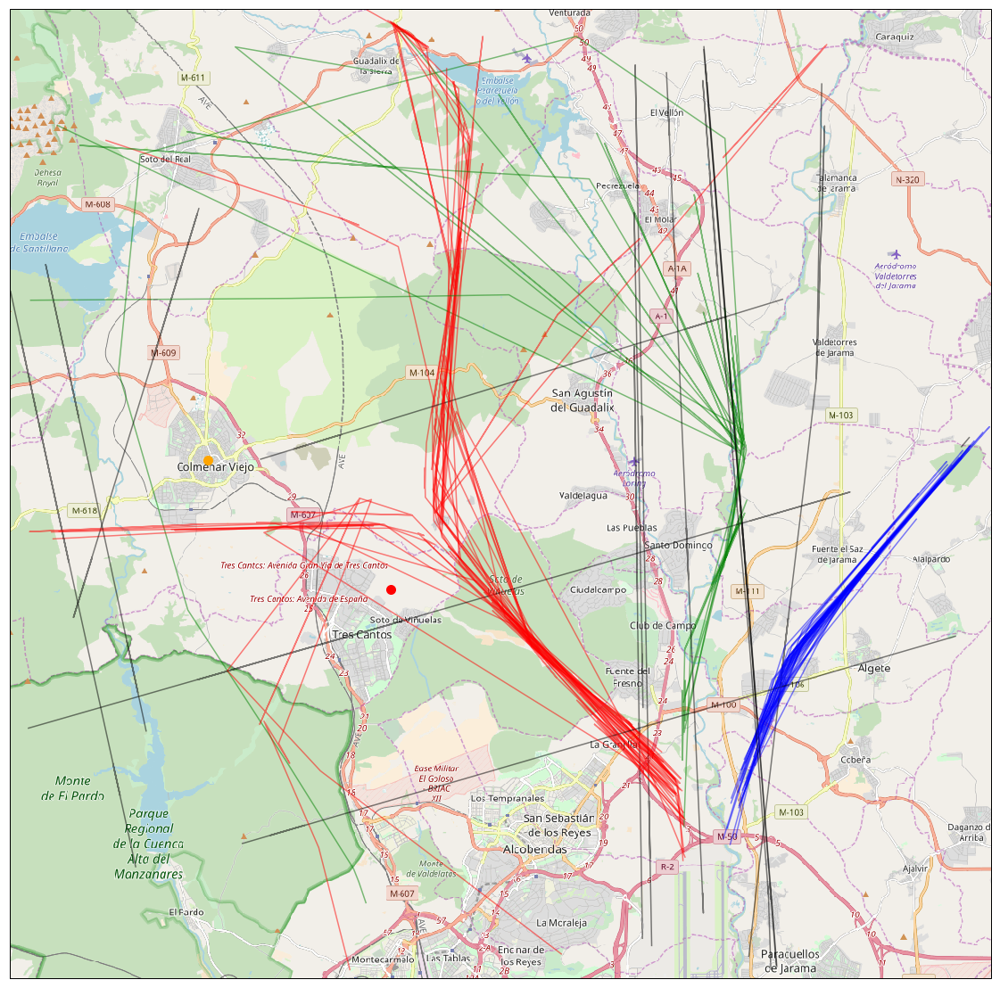

In [17]:
ax = plot_map()
for icao in icaos:
    acs = [ac for ac in aircrafts if ac['Icao'] == icao]
    ax.plot([ac['Long'] for ac in acs], [ac['Lat'] for ac in acs], '-', color = sid_colors[sid_icao.get(icao)],\
            alpha = 0.5, transform=ccrs.Geodetic())

The dictionary of sets below is used to get the set of all ICAOs for a given SID.

In [18]:
sid = {s : {icao for icao in icaos if sid_icao.get(icao) == s} for s in sid_names}

Compute the fraction of aircraft on each SID that produce a reflection.

In [19]:
{s: len(reflections & sid[s] & icaos_shown)/len(sid[s] & icaos_shown) for s in sid_names}

{'delta': 0.0, 'kilo': 0.75, 'tango': 0.8947368421052632}

Plot waterfall showing only aircraft on T.

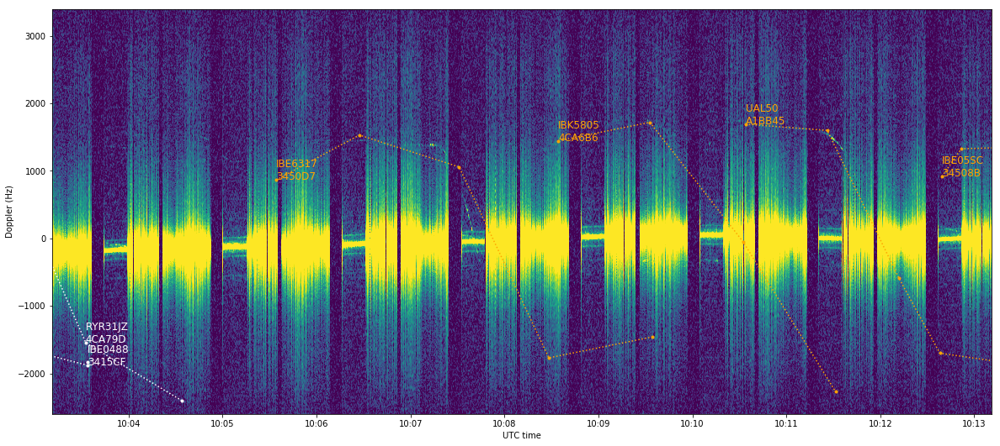

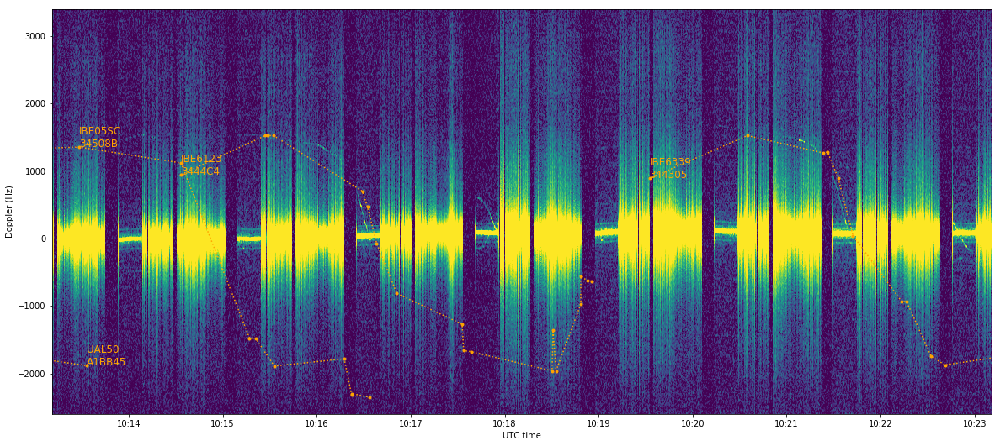

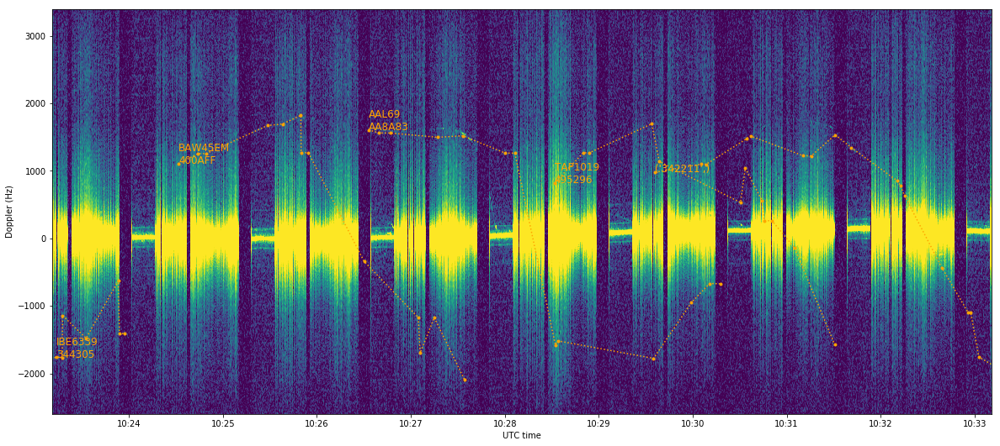

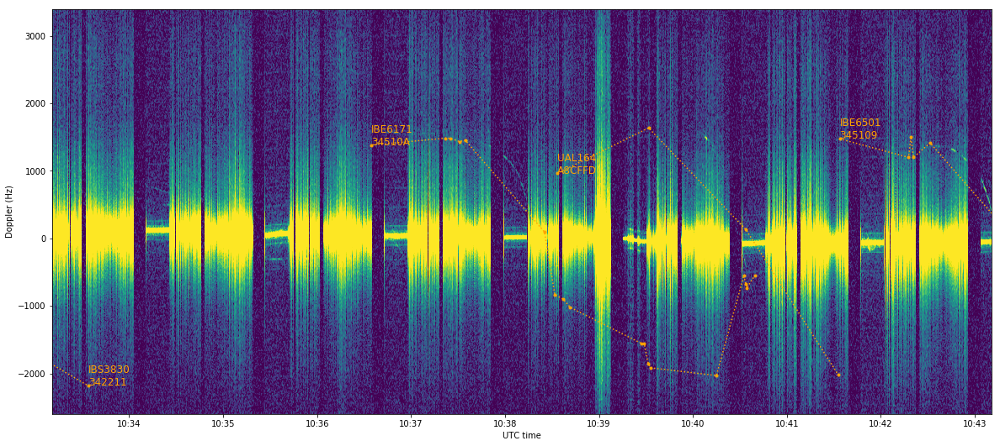

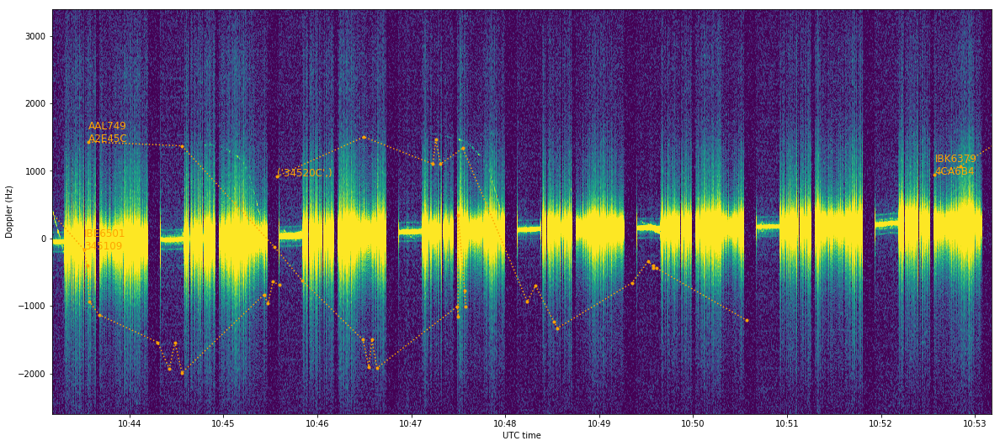

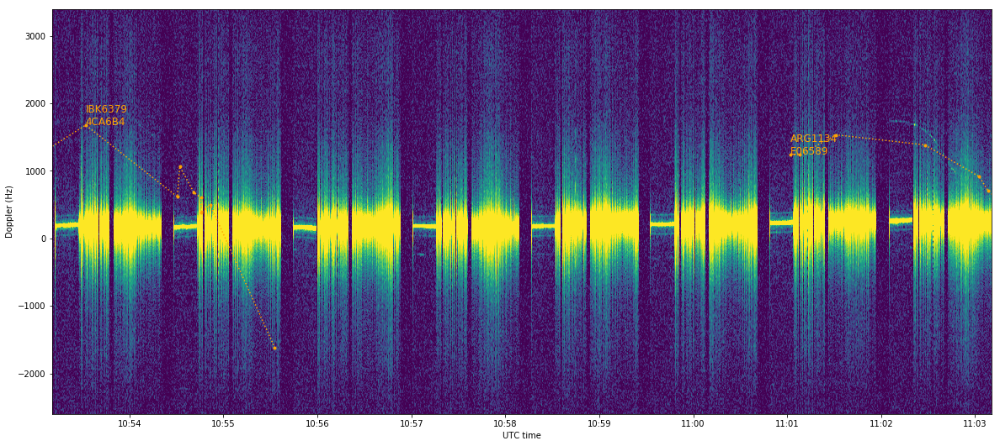

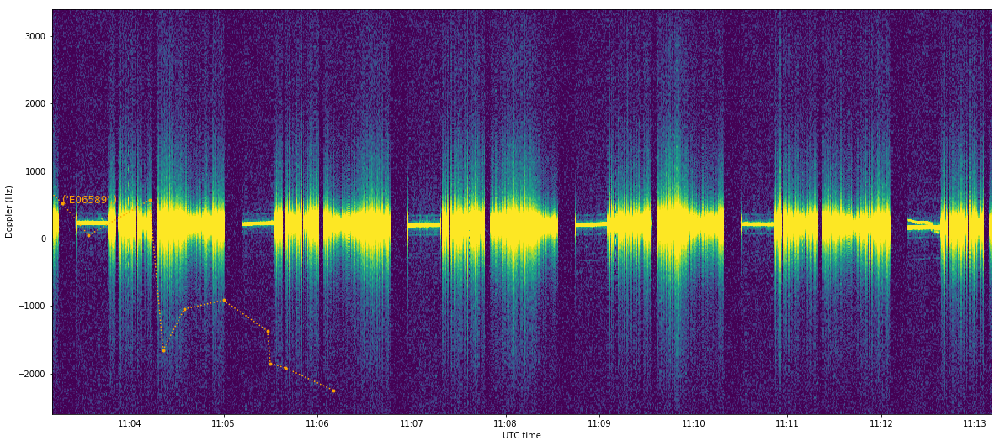

In [20]:
plot_doppler({icao for icao in icaos if sid_icao.get(icao) == 'tango'}, reflections);

Plot waterfall showing only aircraft on T.

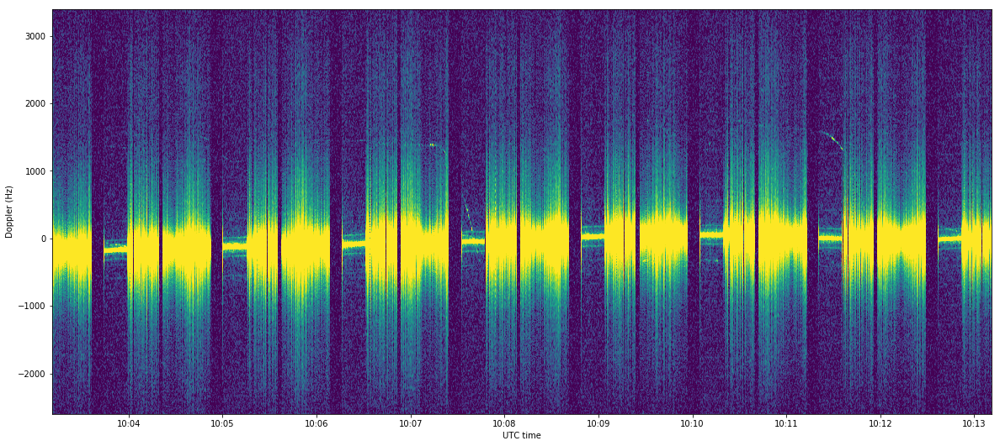

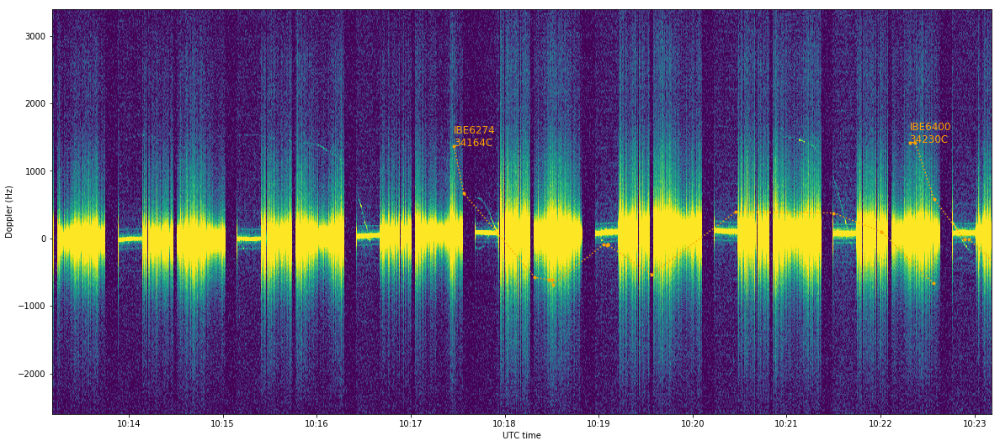

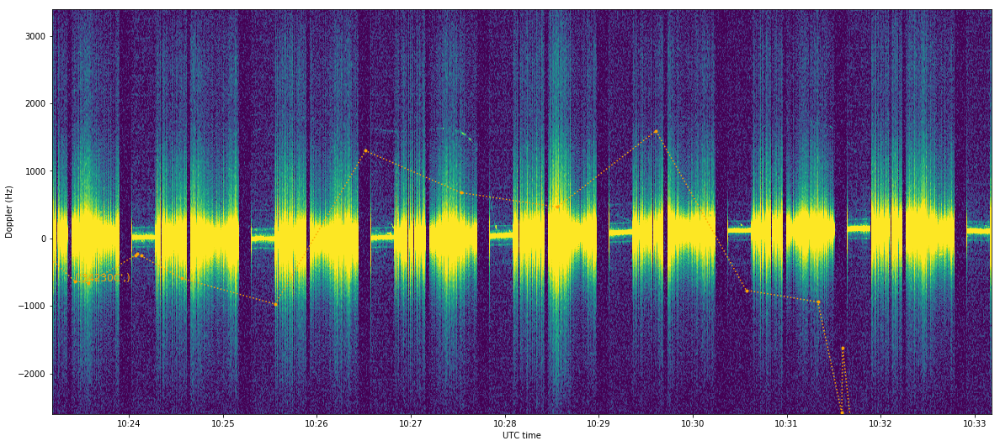

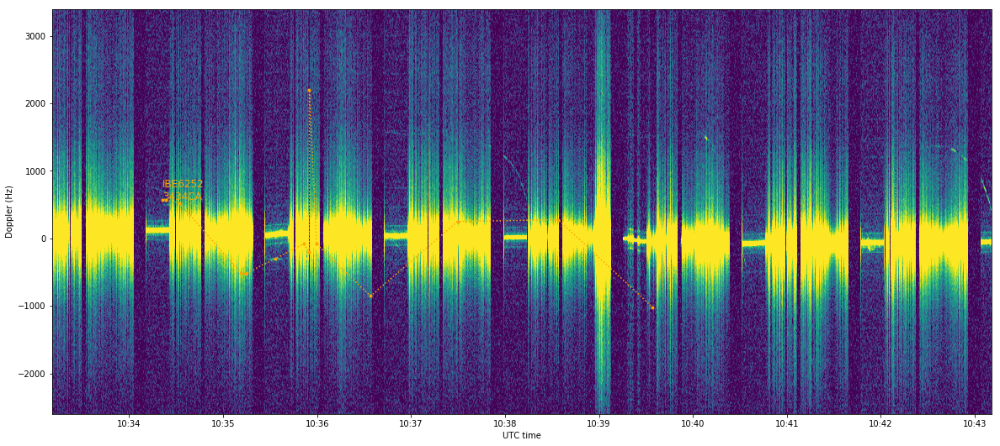

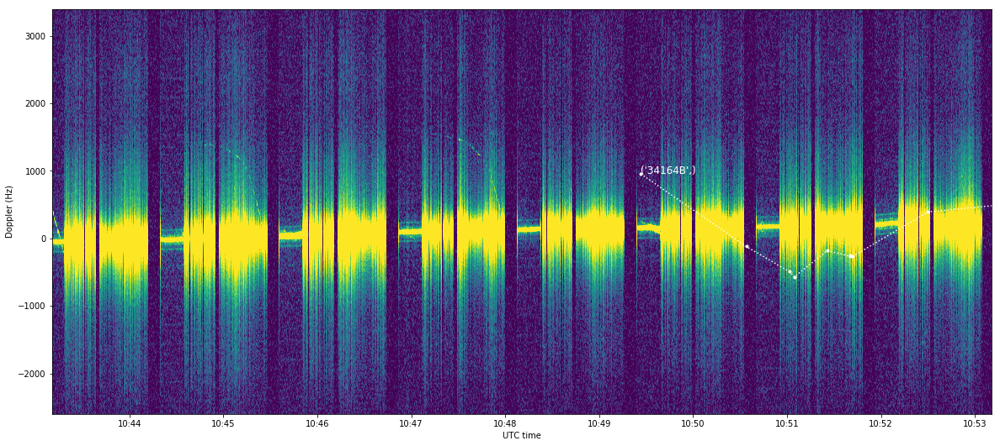

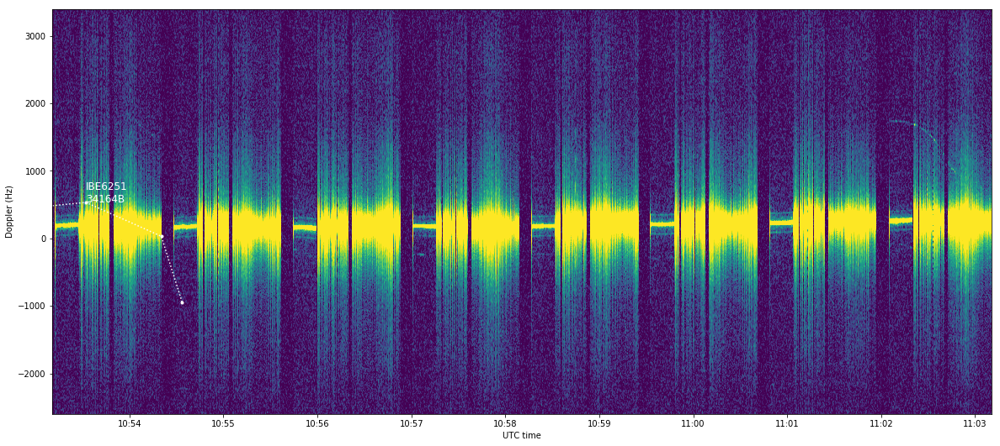

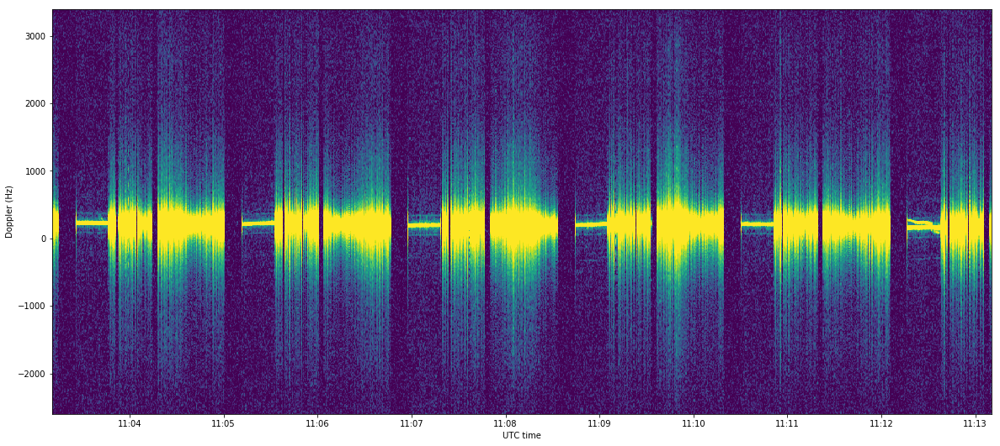

In [21]:
plot_doppler({icao for icao in icaos if sid_icao.get(icao) == 'kilo'}, reflections);